<a href="https://colab.research.google.com/github/MarMarhoun/freelance_work/blob/main/side_projects/Solved_challenge/LifeAnalytics_recruitment_test_Marhoun/test_lifeanalytics.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Recruitment test for LifeAnalytics

Thank you for applying to this position at LifeAnalytics.
First, you will take a recruitment test.
Use StarDist(https://github.com/stardist/stardist) or any other library to link to Google Clab or your local PC, and create a report that recognizes all cells in all images in the sample data linked below. You can send it.
The submission deadline is approximately 4 days.
sample data
https://drive.google.com/drive/folders/11WboE7HZI5Q6ifT22VduaGZJI32A2D2k?usp=sharing

We will give you a reward if you submit an excellent report (original images and segmented images, their comparison data, and code for verification) within the deadline.
Three types of images are required for reporting: the original image, the segmented image, and the merged image of the original image and the segmented image.
All of those images must be included in the report, meaning 84 images must be included in the report.


# Packages installation

In [ ]:
!pip install patool mayavi

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 96.0/96.0 kB 2.1 MB/s eta 0:00:00


In [ ]:
!pip install stardist stardist[util]

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 13.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 71.3/71.3 kB 7.8 MB/s eta 0:00:00


## Import and process the dataset

In [ ]:
import patoolib


outdir="/content/dataset"
archive_path = "/content/drive-download-20240525T155246Z-001.zip"

patoolib.extract_archive(archive_path, outdir=outdir)

INFO patool: Extracting /content/drive-download-20240525T155246Z-001.zip ...
INFO:patool:Extracting /content/drive-download-20240525T155246Z-001.zip ...
INFO patool: ... creating output directory `/content/dataset'.
INFO:patool:... creating output directory `/content/dataset'.
INFO patool: running /usr/bin/7z x -o/content/dataset -- /content/drive-download-20240525T155246Z-001.zip
INFO:patool:running /usr/bin/7z x -o/content/dataset -- /content/drive-download-20240525T155246Z-001.zip
INFO patool:     with input=''
INFO:patool:    with input=''
INFO patool: ... /content/drive-download-20240525T155246Z-001.zip extracted to `/content/dataset'.
INFO:patool:... /content/drive-download-20240525T155246Z-001.zip extracted to `/content/dataset'.


'/content/dataset'

In [ ]:
## # Define a function to load and preprocess the images.

def preprocess_image(path):
  image = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
  image = (image - np.min(image)) / (np.max(image) - np.min(image))
  return image

In [ ]:
image_path = "/content/dataset/Muc1_Ecad_SPC_x20_2_XY10_00035_CH3.tif"

image = preprocess_image(image_path)
image

array([[0.00564972, 0.00564972, 0.00564972, ..., 0.01129944, 0.01129944,
        0.01129944],
       [0.00564972, 0.00564972, 0.00564972, ..., 0.01129944, 0.01129944,
        0.01129944],
       [0.00564972, 0.00564972, 0.00564972, ..., 0.01129944, 0.01129944,
        0.01129944],
       ...,
       [0.        , 0.00564972, 0.00564972, ..., 0.01129944, 0.01694915,
        0.01694915],
       [0.00564972, 0.00564972, 0.00564972, ..., 0.01129944, 0.01694915,
        0.01694915],
       [0.00564972, 0.00564972, 0.00564972, ..., 0.01129944, 0.01129944,
        0.01129944]])

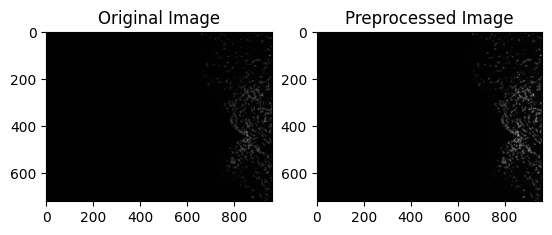

In [ ]:
# Define a function to visualise the preprocessed images.


import matplotlib.pyplot as plt

def display_preprocessed_image(path, figsize=(10, 5)):
  # Load the image
  image = cv2.imread(path)


  # Display the original image
  plt.subplot(121, figsize=figsize)
  plt.imshow(image)
  plt.title('Original Image')

  # Preprocess the image
  image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
  image = (image - np.min(image)) / (np.max(image) - np.min(image))

  # Display the preprocessed image
  plt.subplot(122)
  plt.imshow(image, cmap='gray')
  plt.title('Preprocessed Image')

  # Show the plot
  plt.show()

image_path = "/content/dataset/Muc1_Ecad_SPC_x20_2_XY10_00035_CH3.tif"
display_preprocessed_image(image_path)


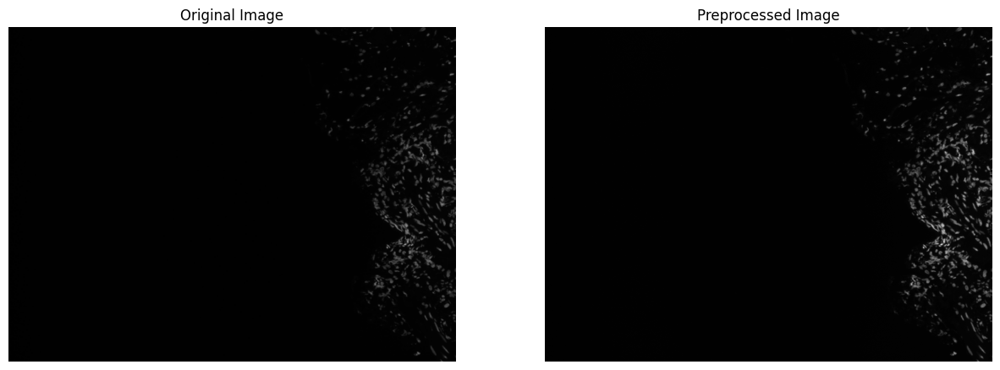

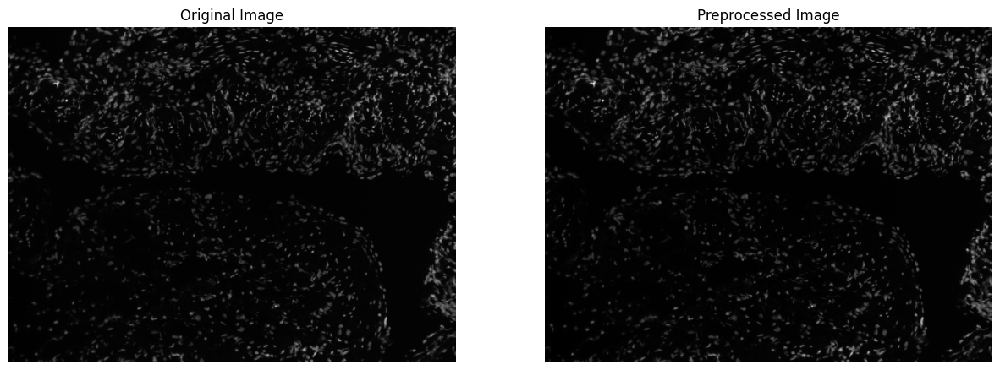

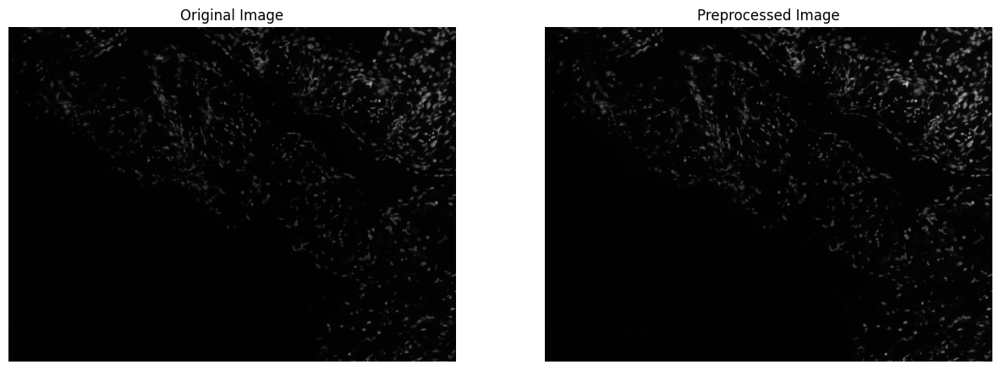

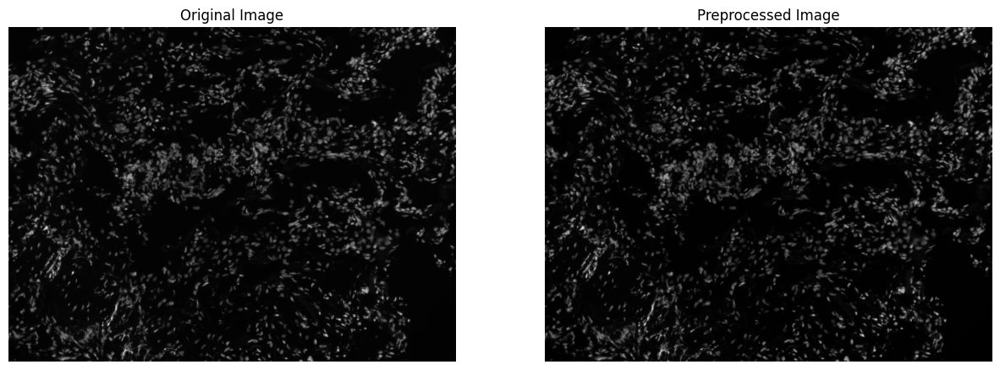

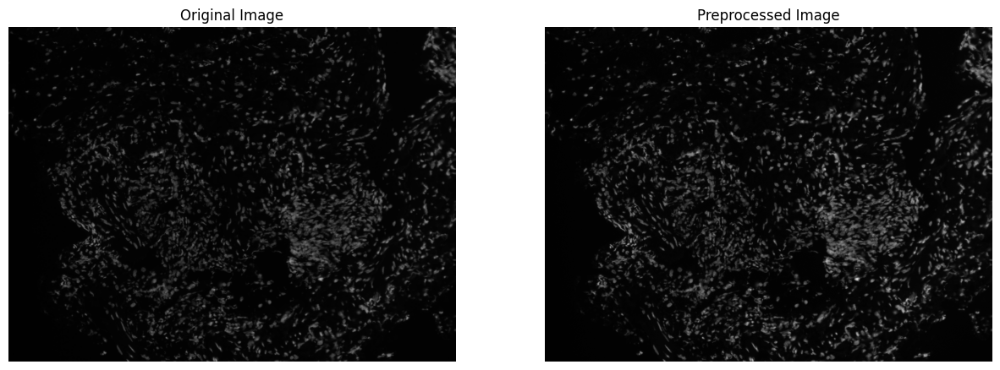

...

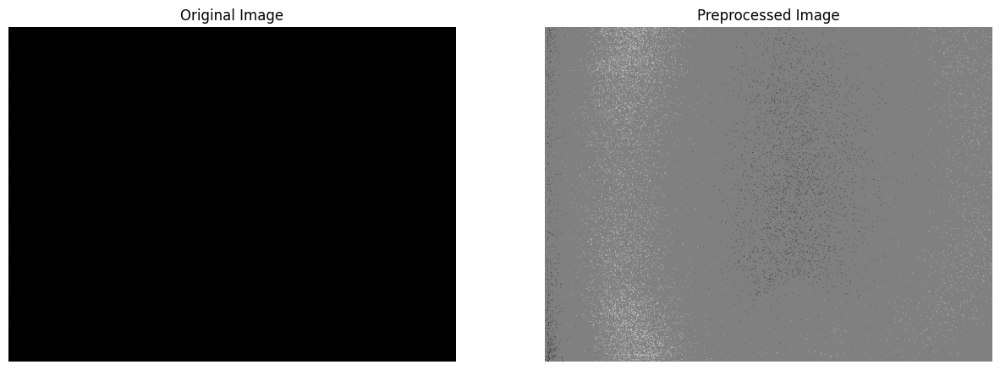

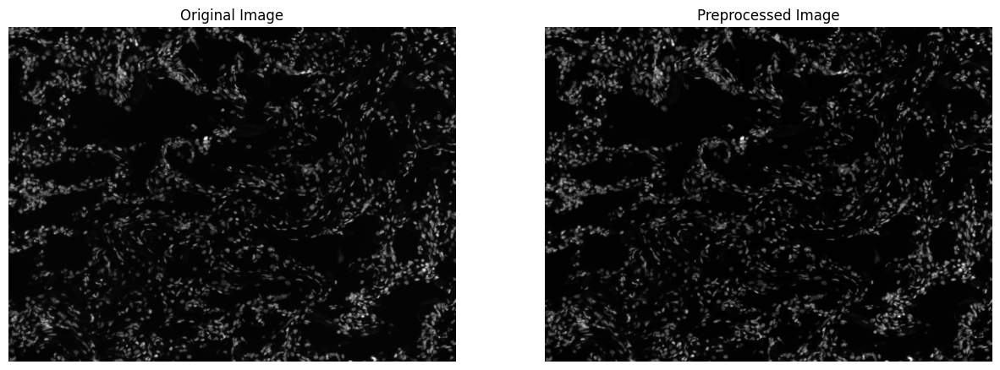

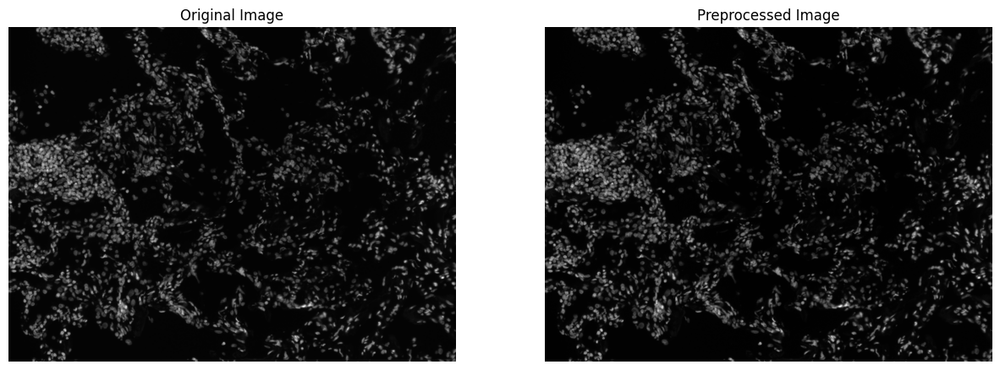

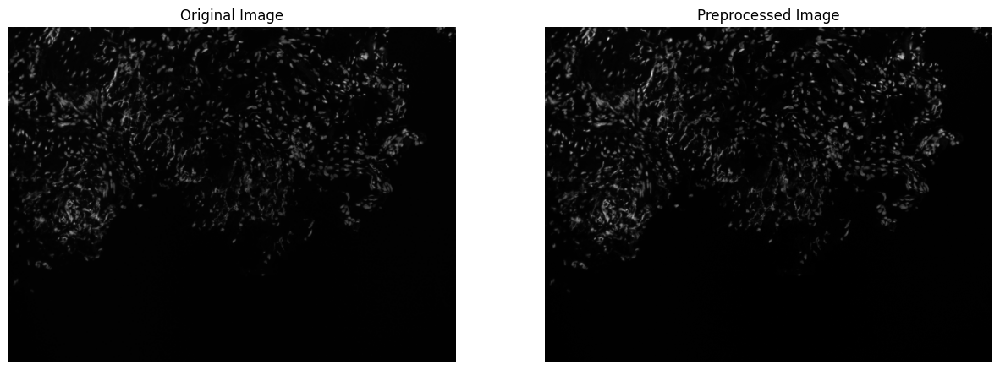

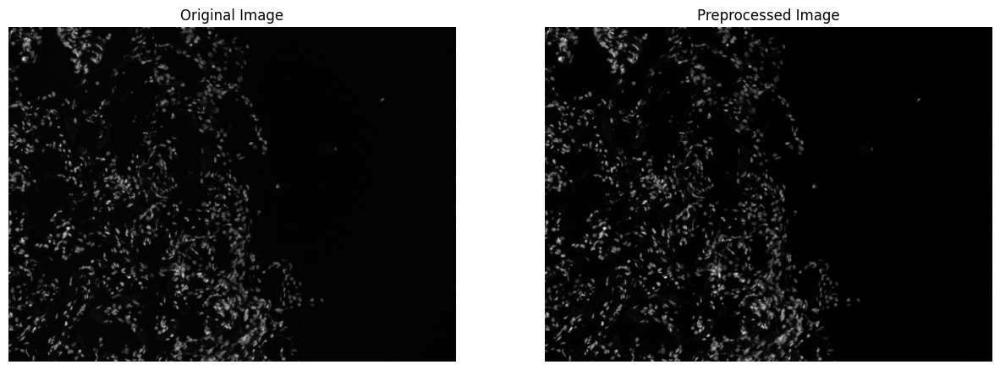

In [ ]:
image_folder = '/content/dataset'
image_paths = glob.glob(os.path.join(image_folder, '*.tif'))

for image_path in image_paths:
    display_preprocessed_image(image_path)


# Define the model

In [ ]:
# prints a list of available models
StarDist2D.from_pretrained()

There are 4 registered models for 'StarDist2D':

Name                  Alias(es)
────                  ─────────
'2D_versatile_fluo'   'Versatile (fluorescent nuclei)'
'2D_versatile_he'     'Versatile (H&E nuclei)'
'2D_paper_dsb2018'    'DSB 2018 (from StarDist 2D paper)'
'2D_demo'             None


In [ ]:
from stardist.data import test_image_nuclei_2d
from stardist.plot import render_label
from csbdeep.utils import normalize
import matplotlib.pyplot as plt

# You can choose any model from the following algorithms
model_names = ['2D_versatile_fluo','2D_versatile_he', '2D_paper_dsb2018', '2D_demo']


def segment_image(image):
  model = StarDist2D.from_pretrained(model_names[0])
  labels, _ = model.predict_instances(normalize(image))
  return labels

In [ ]:
# Define the visualisation function for the original images and segmented

import matplotlib.pyplot as plt

def display_images(image, labels, figsize=(10, 5)):
  # Create a figure with the specified size
  fig, axs = plt.subplots(1, 2, figsize=figsize)

  # Display the original image
  axs[0].imshow(image, cmap="gray")
  axs[0].axis("off")
  axs[0].set_title("Original Image")

  # Display the preprocessed image
  axs[1].imshow(render_label(labels, img=image))
  axs[1].axis("off")
  axs[1].set_title("Prediction + Input Overlay")

  # Show the plot
  plt.show()



## Segment the image using the trained model

Segment the image using the trained model:

Found model '2D_versatile_fluo' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.


Text(0.5, 1.0, 'prediction + input overlay')

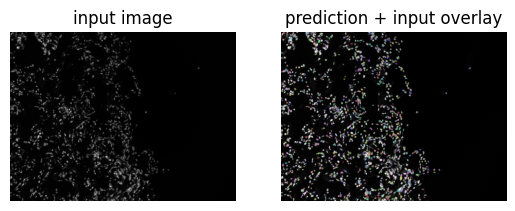

In [ ]:
from stardist.data import test_image_nuclei_2d
from stardist.plot import render_label
from csbdeep.utils import normalize
import matplotlib.pyplot as plt

# creates a pretrained model
model = StarDist2D.from_pretrained('2D_versatile_fluo')

labels, _ = model.predict_instances(normalize(image))

plt.subplot(1,2,1)
plt.imshow(image, cmap="gray")
plt.axis("off")
plt.title("input image")

plt.subplot(1,2,2)
plt.imshow(render_label(labels, img=image))
plt.axis("off")
plt.title("prediction + input overlay")

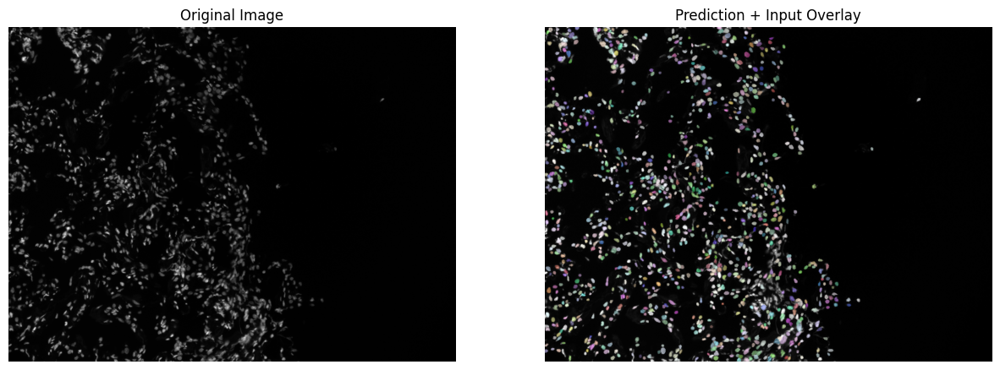

In [ ]:
display_images(image, labels, figsize=(15, 7.5))


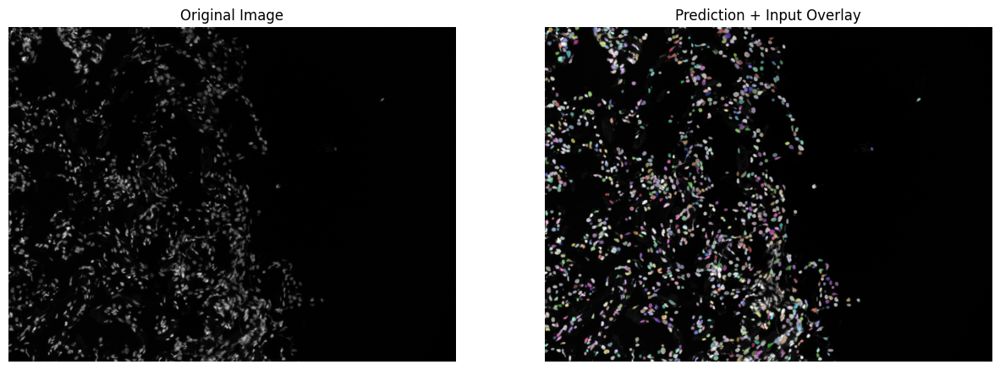

In [ ]:
display_images(image, labels, figsize=(15, 7.5))


In [ ]:
from stardist.models import StarDist2D

# prints a list of available models
StarDist2D.from_pretrained()


There are 4 registered models for 'StarDist2D':

Name                  Alias(es)
────                  ─────────
'2D_versatile_fluo'   'Versatile (fluorescent nuclei)'
'2D_versatile_he'     'Versatile (H&E nuclei)'
'2D_paper_dsb2018'    'DSB 2018 (from StarDist 2D paper)'
'2D_demo'             None
Found model '2D_versatile_fluo' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.


## Merge the original image with the segmented image

Merge the original image with the segmented image:

In [ ]:
def merge_images(image, seg_image):
    merged_image = np.zeros((image.shape[0], image.shape[1], 3))
    merged_image[:, :, 0] = image
    merged_image[:, :, 1] = seg_image
    merged_image[:, :, 2] = image
    return merged_image



In [ ]:
merged_image = merge_images(image, labels)#, figsize=(15, 7.5))

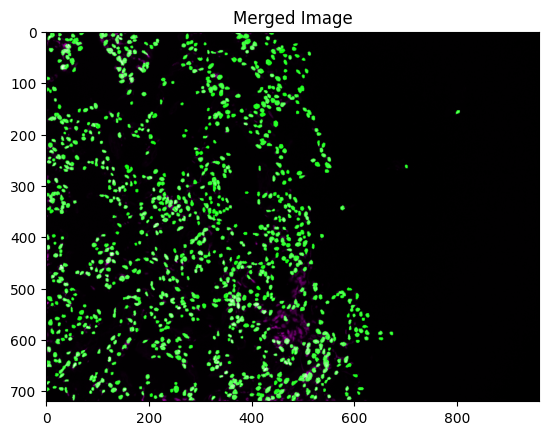

In [ ]:
plt.imshow(merged_image)#, cmap='gray')
plt.title('Merged Image')

  # Show the plot
plt.show()

In [ ]:
def display_all_images(image, labels, merged_image, figsize=(10, 5)):
  # Create a figure with the specified size
  fig, axs = plt.subplots(1, 3, figsize=figsize)

  # Display the original image
  axs[0].imshow(image, cmap="gray")
  axs[0].axis("off")
  axs[0].set_title("Original Image")

  # Display the preprocessed image
  axs[1].imshow(render_label(labels, img=image))
  axs[1].axis("off")
  axs[1].set_title("Prediction + Input Overlay")

  # Display the merged image
  axs[2].imshow(merged_image)
  axs[2].axis("off")
  axs[2].set_title("Merged Image")
  # Show the plot
  plt.show()

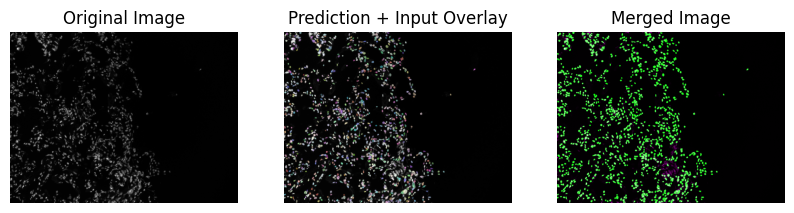

In [ ]:
display_all_images(image, labels, merged_image, figsize=(10, 5))

In [ ]:
# Define a function to segment the images using StarDist.
# Define a function to segment the images using StarDist.
def segment_image(model, image):
    if model is None:
        raise ValueError("Model is not loaded")
    elif not model.model_loaded:
        model.from_pretrained('2D_versatile_fluo')
    else:
        seg = StarDist2D.predict(image, model)
        return seg

Found model '2D_versatile_fluo' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.

 ################################################################################################################################################################## 

Found model '2D_versatile_fluo' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.


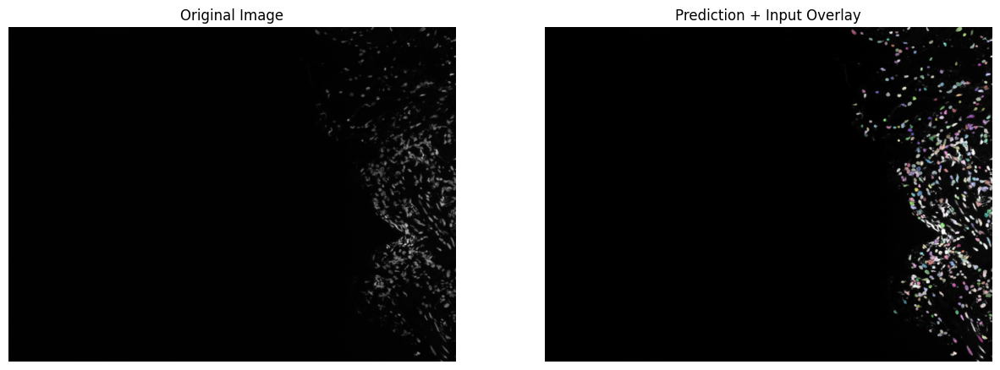

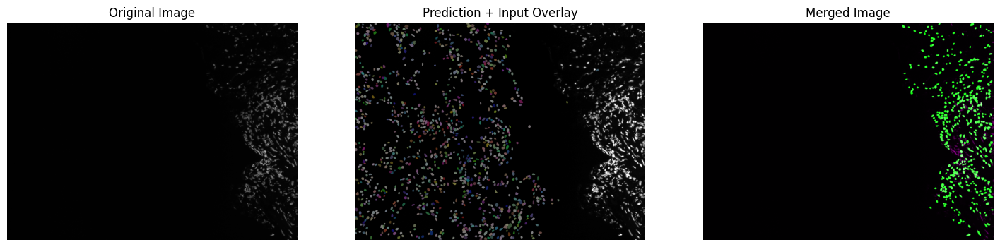




 ################################################################################################################################################################## 

Found model '2D_versatile_fluo' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.


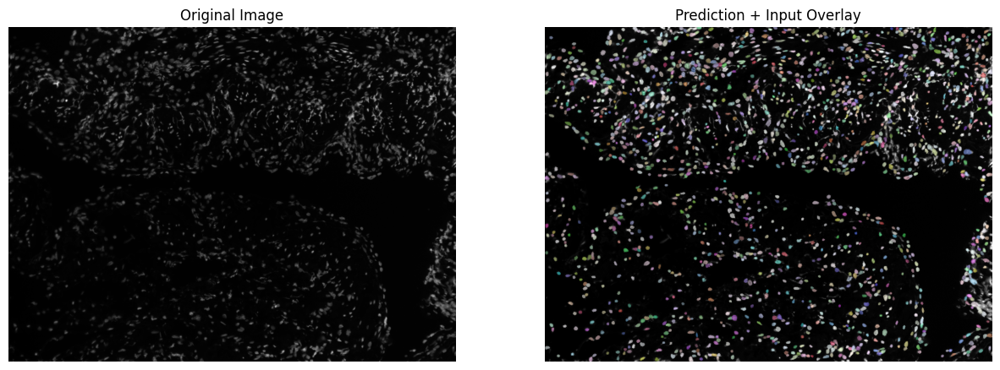

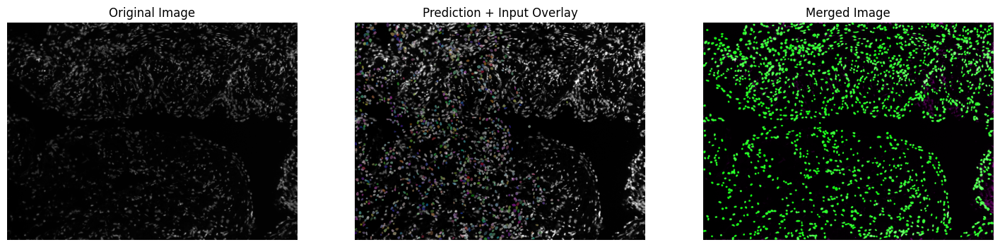




 ################################################################################################################################################################## 

Found model '2D_versatile_fluo' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.


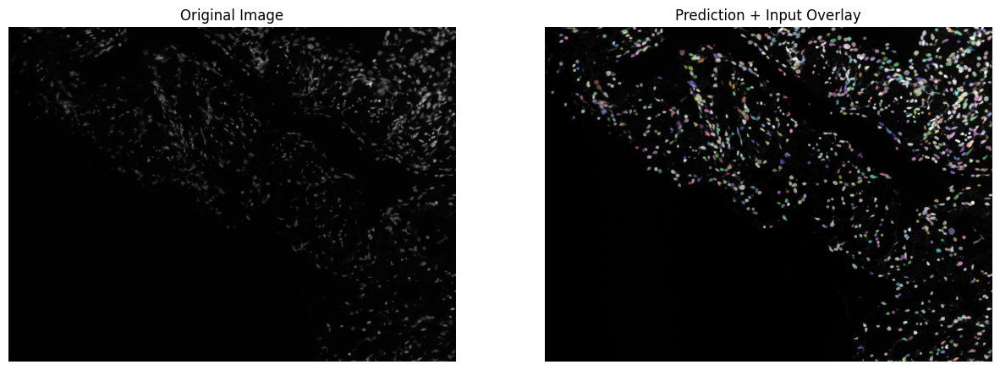

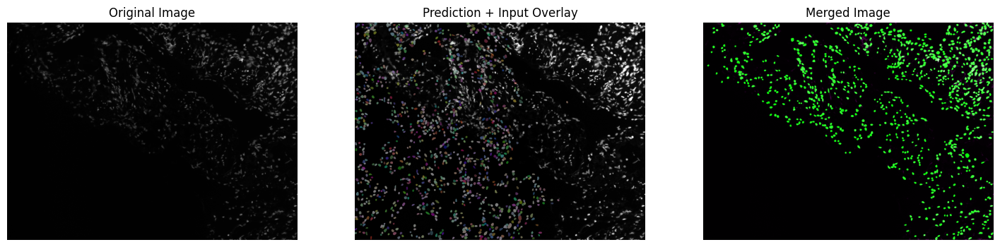




 ################################################################################################################################################################## 

Found model '2D_versatile_fluo' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.


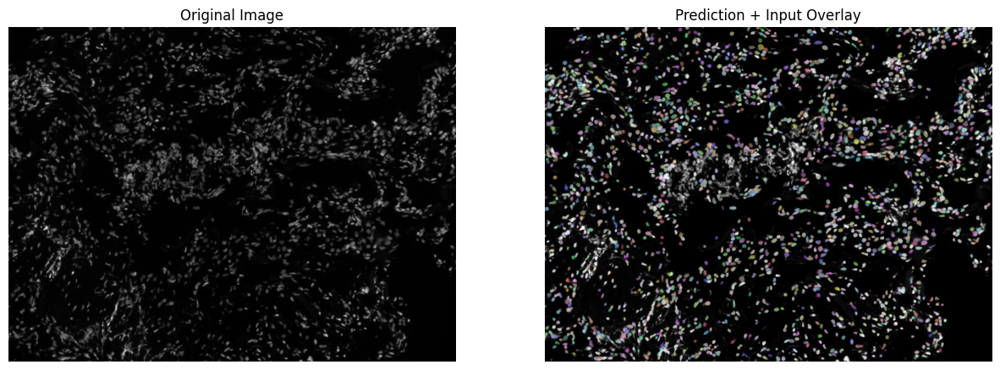

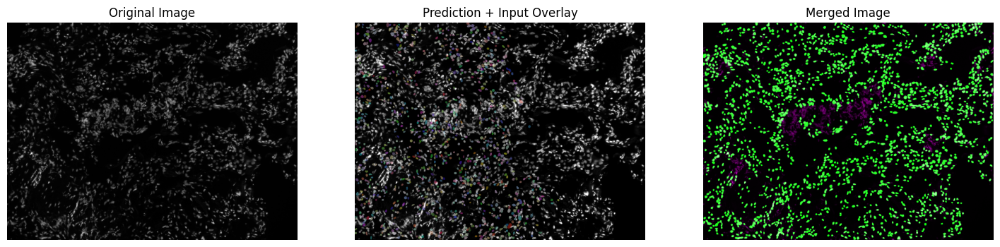




 ################################################################################################################################################################## 

Found model '2D_versatile_fluo' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.


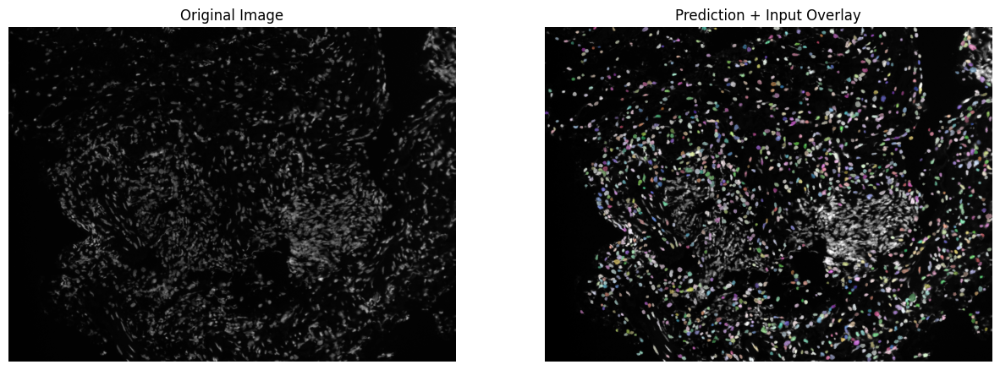

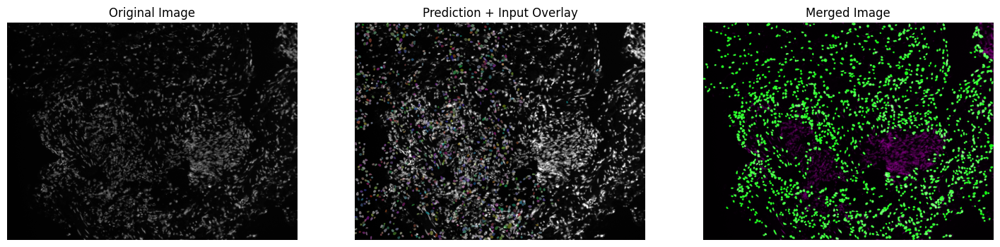




 ################################################################################################################################################################## 

Found model '2D_versatile_fluo' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.


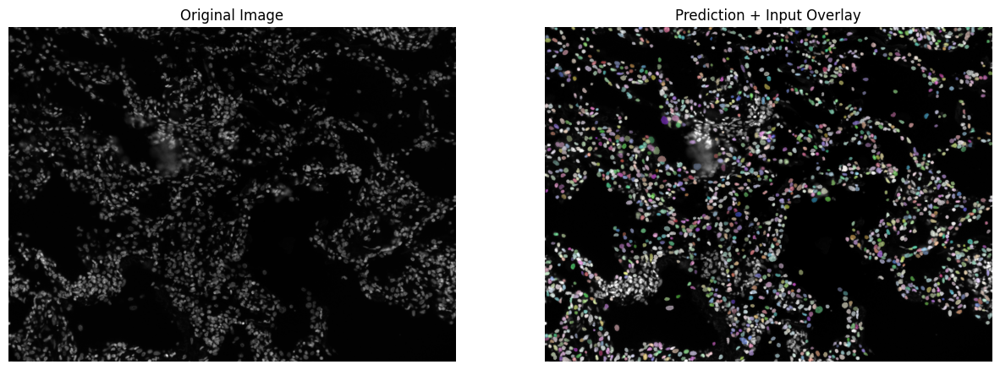

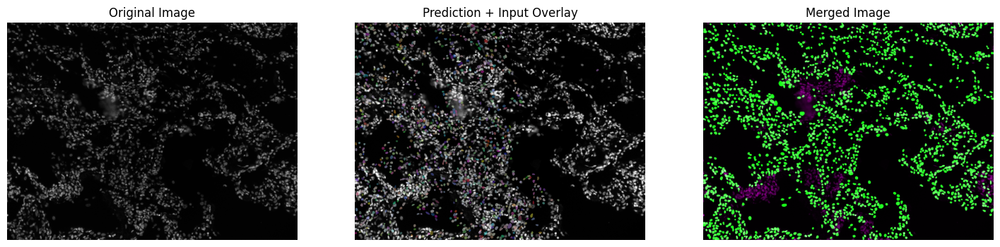




 ################################################################################################################################################################## 

Found model '2D_versatile_fluo' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.


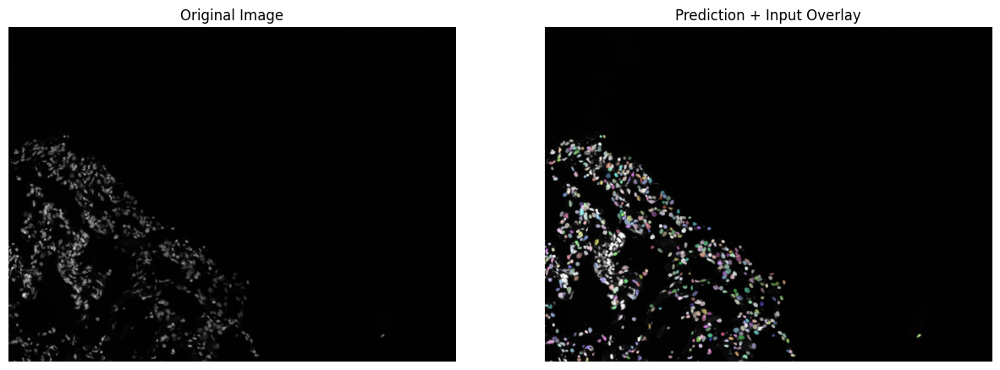

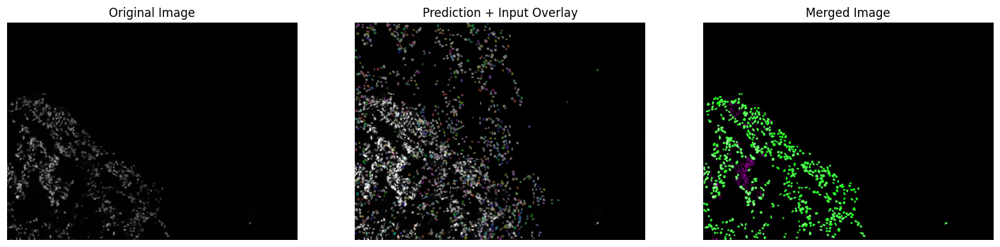




 ################################################################################################################################################################## 

Found model '2D_versatile_fluo' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.


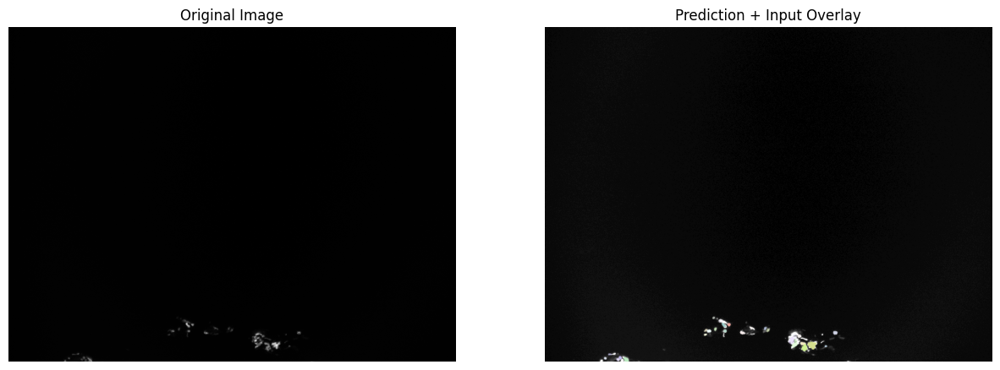

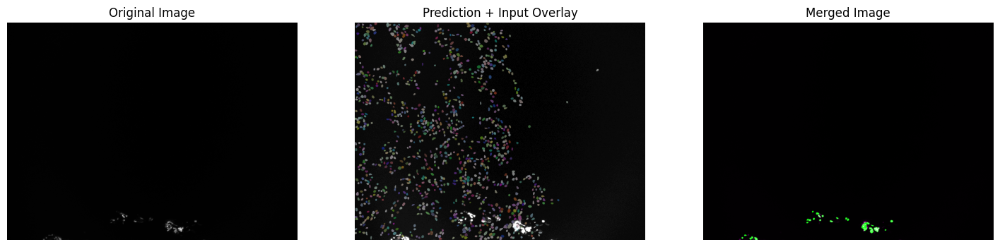




 ################################################################################################################################################################## 

Found model '2D_versatile_fluo' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.


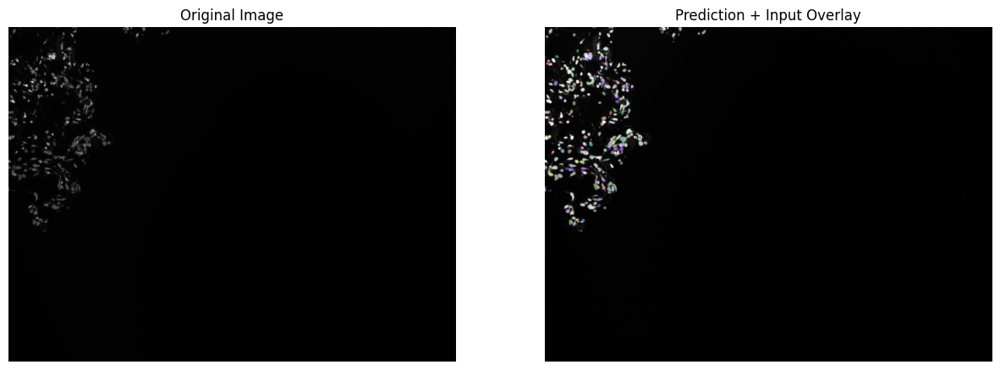

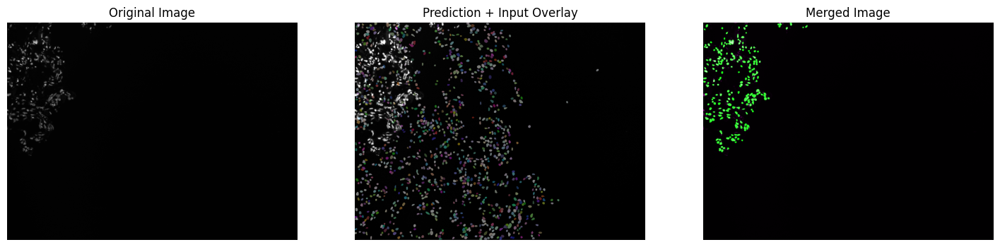




 ################################################################################################################################################################## 

Found model '2D_versatile_fluo' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.


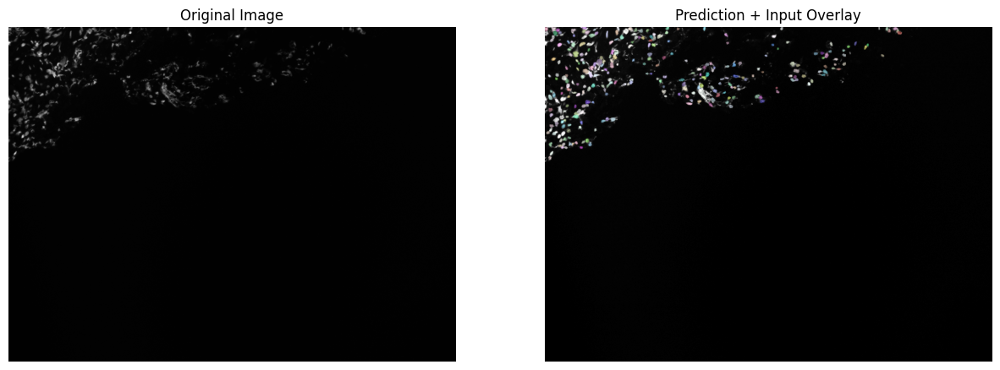

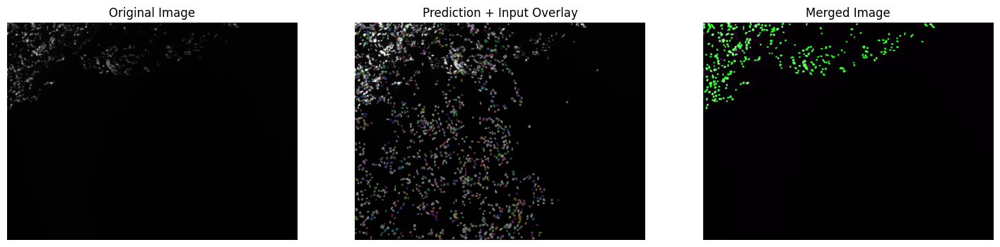




 ################################################################################################################################################################## 

Found model '2D_versatile_fluo' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.


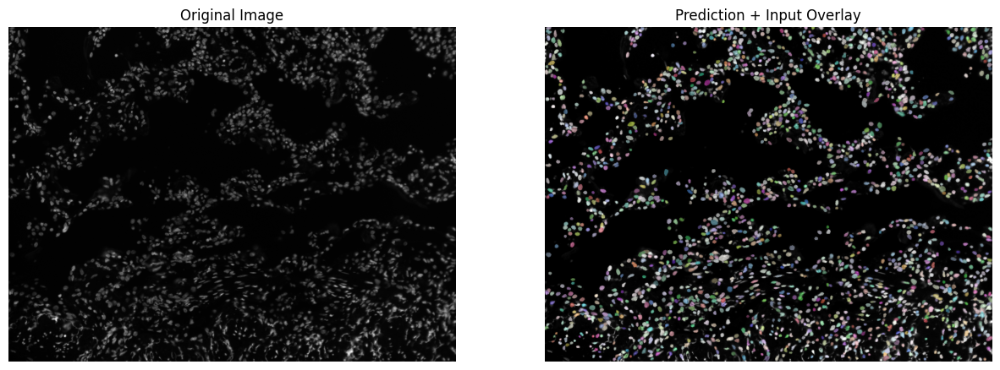

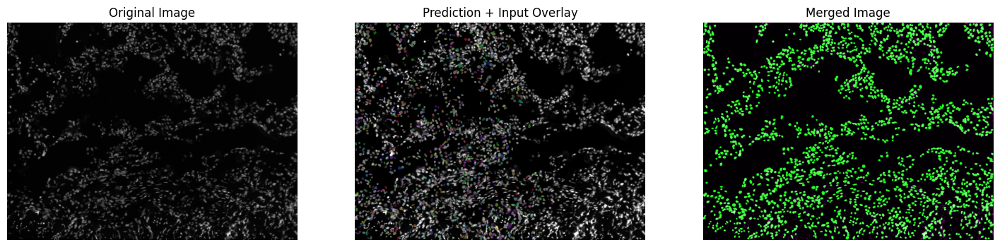




 ################################################################################################################################################################## 

Found model '2D_versatile_fluo' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.


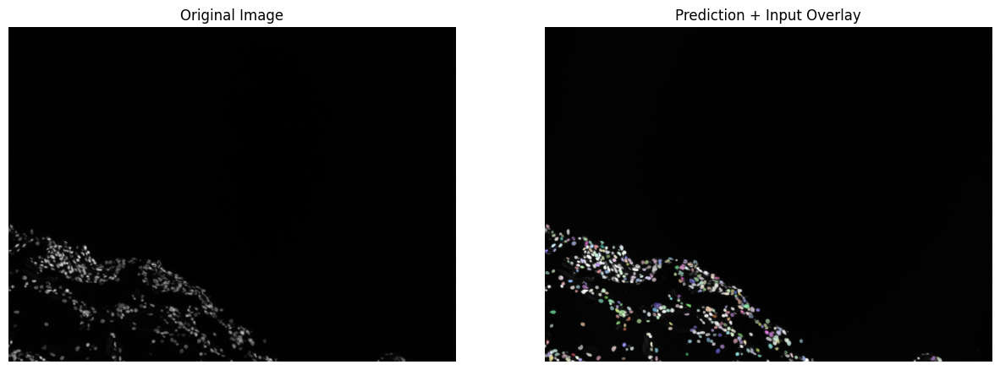

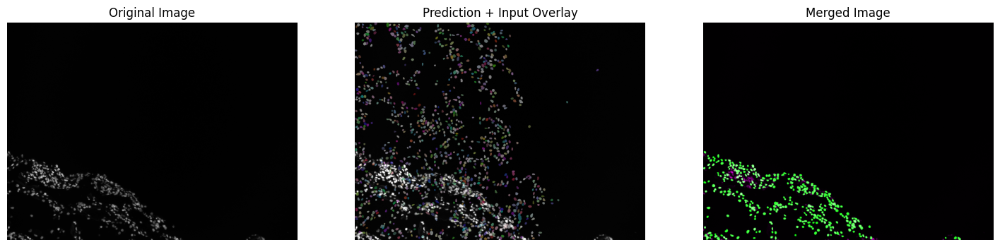




 ################################################################################################################################################################## 

Found model '2D_versatile_fluo' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.


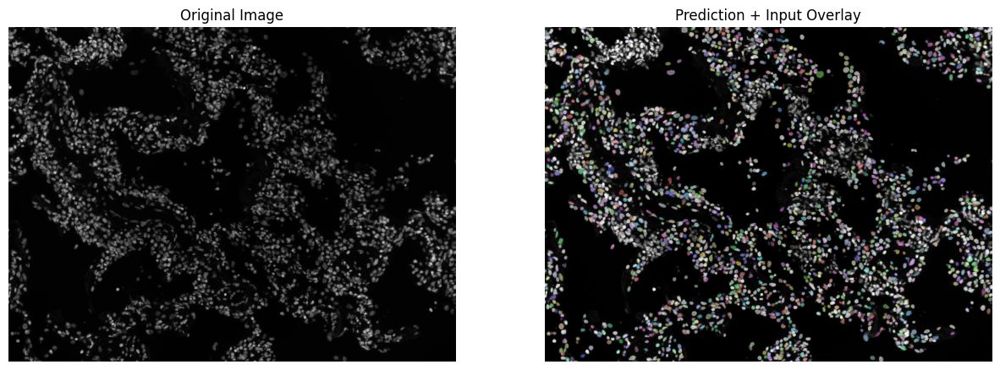

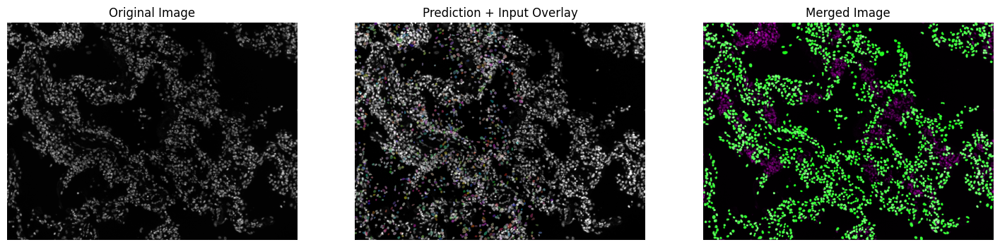




 ################################################################################################################################################################## 

Found model '2D_versatile_fluo' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.


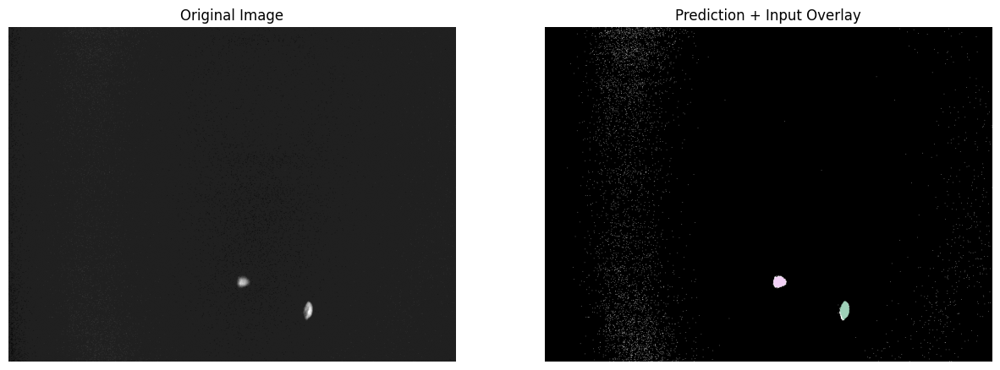

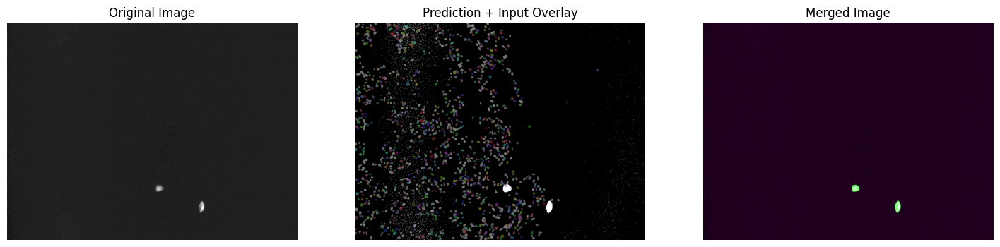




 ################################################################################################################################################################## 

Found model '2D_versatile_fluo' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.


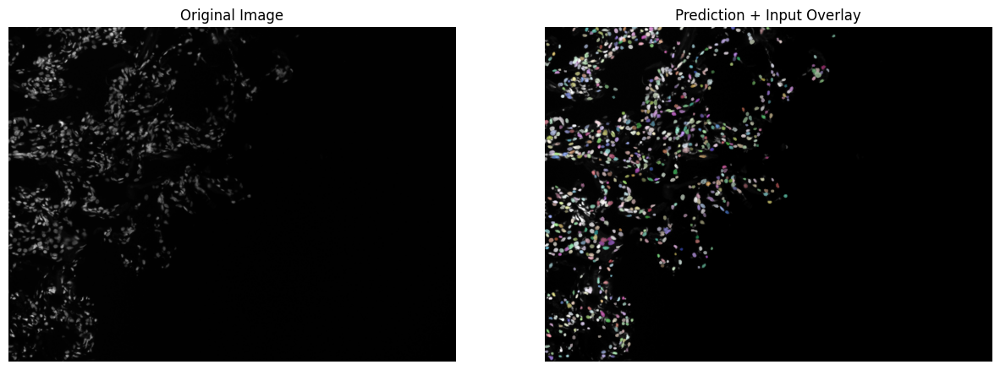

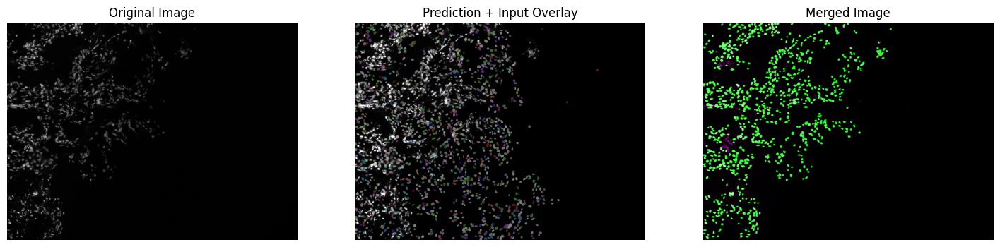




 ################################################################################################################################################################## 

Found model '2D_versatile_fluo' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.


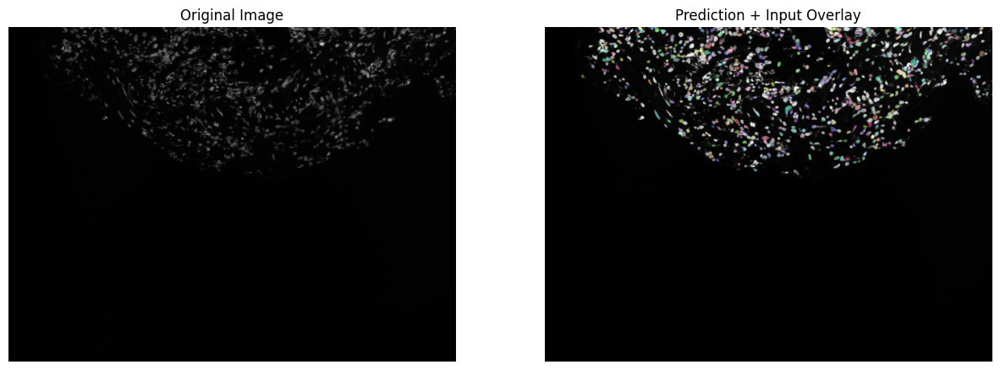

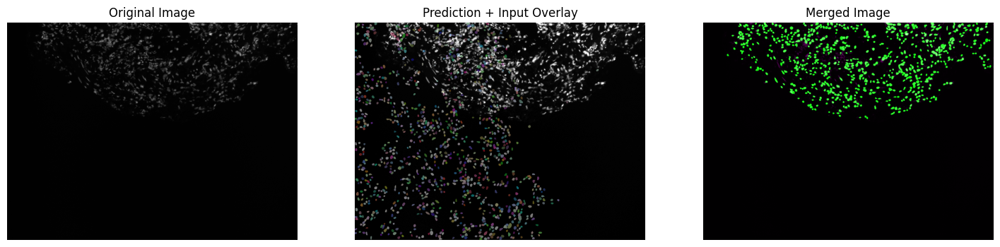




 ################################################################################################################################################################## 

Found model '2D_versatile_fluo' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.


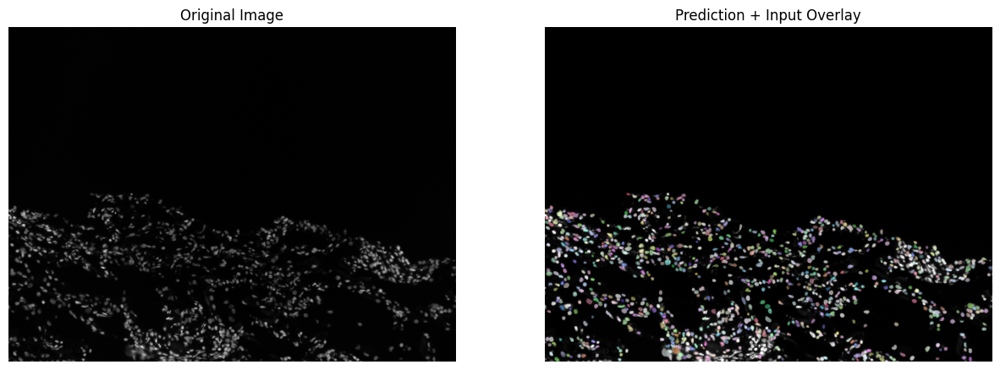

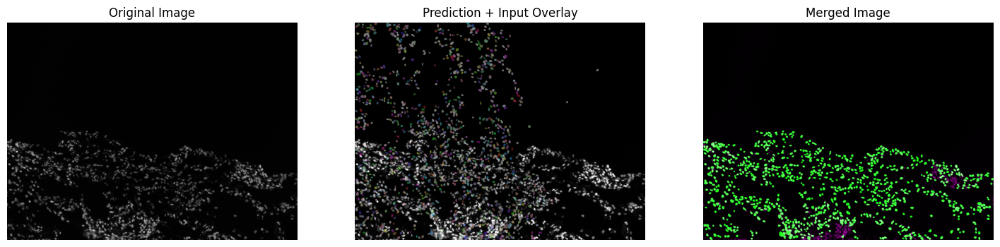




 ################################################################################################################################################################## 

Found model '2D_versatile_fluo' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.


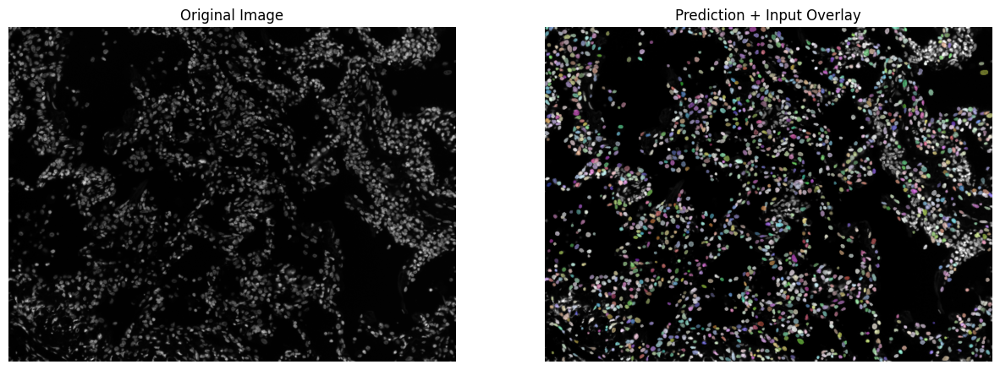

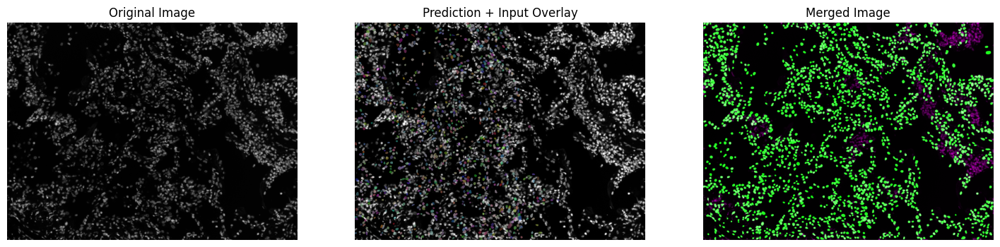




 ################################################################################################################################################################## 

Found model '2D_versatile_fluo' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.


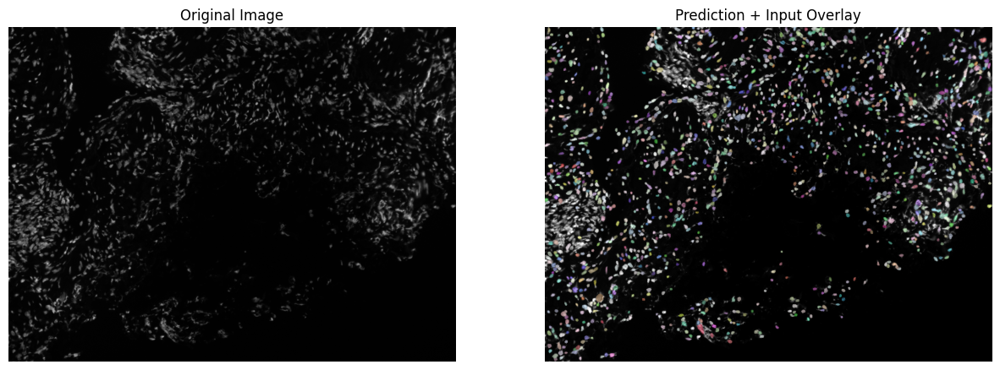

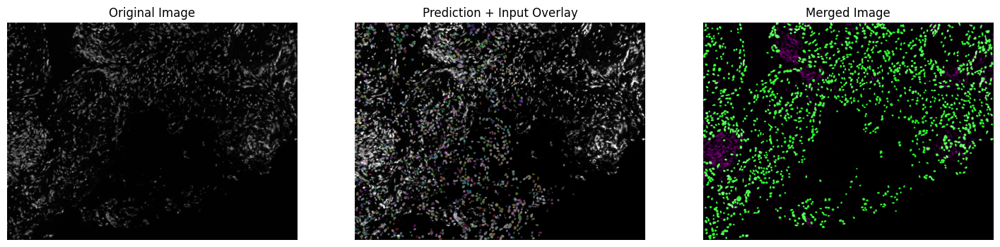




 ################################################################################################################################################################## 

Found model '2D_versatile_fluo' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.


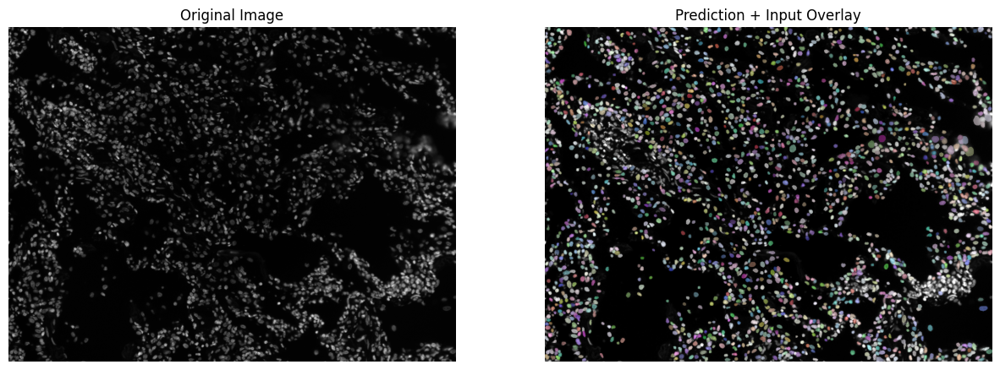

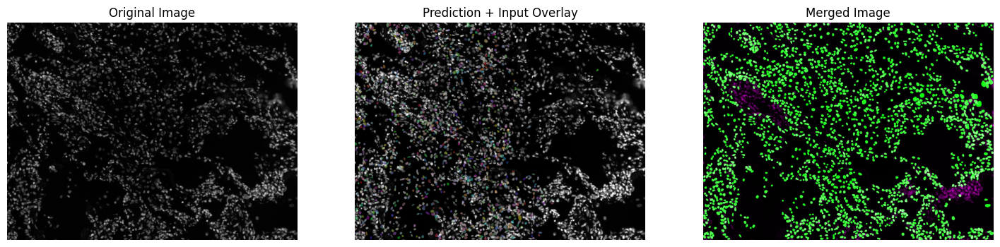




 ################################################################################################################################################################## 

Found model '2D_versatile_fluo' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.


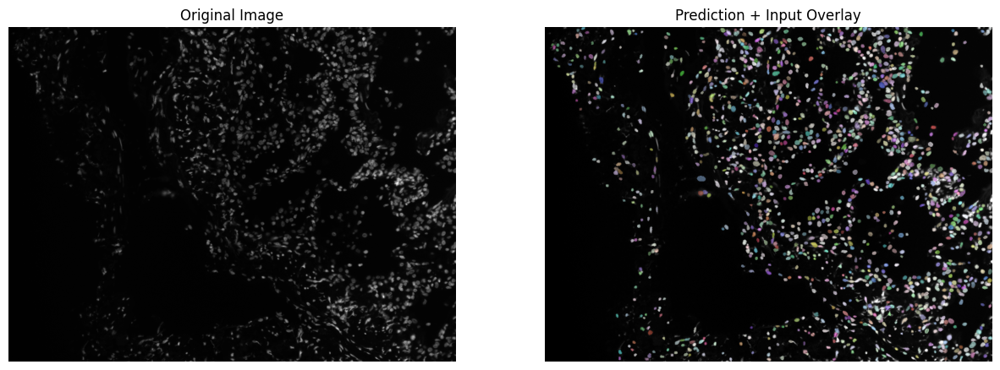

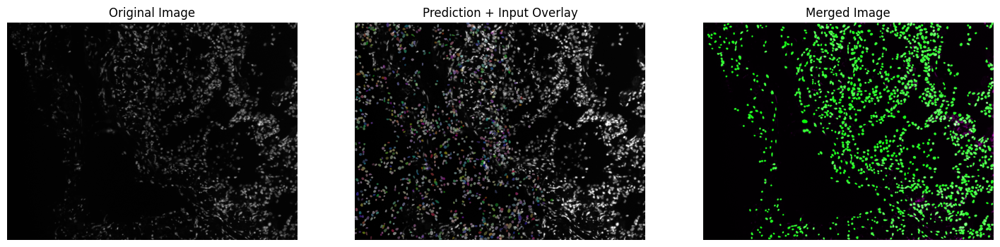




 ################################################################################################################################################################## 

Found model '2D_versatile_fluo' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.


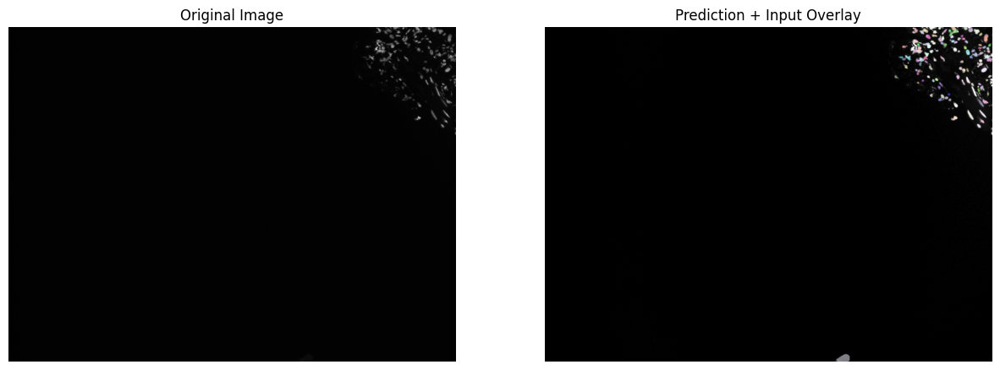

In [ ]:
# Load the images, segment them, and visualize the results.
from stardist.models import StarDist2D
image_folder = '/content/dataset'
image_paths = glob.glob(os.path.join(image_folder, '*.tif'))

model = StarDist2D.from_pretrained('2D_versatile_fluo')

for image_path in image_paths:
    print("\n ##################################################################################################################################################################")
    image = preprocess_image(image_path)
    seg = segment_image(image)
    display_images(image, seg, figsize=(15, 7.5))
    print('\n')
    merged_image = merge_images(image, seg)#, figsize=(15, 7.5))
    display_all_images(image, labels, merged_image, figsize=(18, 7.5))
    print('\n')


##  Generate a report

Generate a report with the original image, segmented image, and merged image:

In [ ]:
import os
import glob
import cv2
import numpy as np
import matplotlib.pyplot as plt
from stardist.data import test_image_nuclei_2d
from stardist.models import StarDist2D
from stardist.plot import render_label
from csbdeep.utils import normalize


def generate_report(image_path, output_path):
    # Load the image
    image = preprocess_image(image_path)

    # Segment the image
    labels = segment_image(image)

    # Display the images
    display_images(image, labels, figsize=(15, 7.5))

    # Save the original image
    original_image_path = os.path.join(output_path, 'original_image.png')
    cv2.imwrite(original_image_path, (image * 255).astype(np.uint8))

    # Save the segmentation mask
    segmentation_mask_path = os.path.join(output_path, 'segmentation_mask.png')
    cv2.imwrite(segmentation_mask_path, (render_label(labels, img=image) * 255).astype(np.uint8))

    # Save the merged image
    merged_image = merge_images(image, labels)
    merged_image_path = os.path.join(output_path, 'merged_image.png')
    cv2.imwrite(merged_image_path, (merged_image * 255).astype(np.uint8))

    # Generate the report
    with open(os.path.join(output_path, 'report.txt'), 'w') as report:
        report.write('Image Path: {}\n'.format(image_path))
        report.write('Number of Nuclei: {}\n'.format(len(np.unique(labels))))
        report.write('Original Image Path: {}\n'.format(original_image_path))
        report.write('Segmentation Mask Path: {}\n'.format(segmentation_mask_path))
        report.write('Merged Image Path: {}\n'.format(merged_image_path))

In [ ]:
image_folder = '/content/dataset'
image_paths = glob.glob(os.path.join(image_folder, '*.tif'))
output_folder = '/content/output'

for image_path in image_paths:
    output_path = os.path.join(output_folder, os.path.basename(image_path).split('.')[0])
    os.makedirs(output_path, exist_ok=True)
    generate_report(image_path, output_path)

In [ ]:
# Define a function to zip the contents of a folder:

import os
import shutil
import zipfile

def zip_folder(folder_path, output_zip_path):
    """Zips the contents of a folder into a zip file.

    Args:
        folder_path: The path to the folder to be zipped.
        output_zip_path: The path to the output zip file.
    """
    with zipfile.ZipFile(output_zip_path, "w") as zip_file:
        for root, dirs, files in os.walk(folder_path):
            for file in files:
                file_path = os.path.join(root, file)
                zip_file.write(file_path)

In [ ]:
# Then, you can use the 'zip_folder' function to download a folder as a zip file:

folder_path = "/content/output" # Souce folder
output_zip_path = "/content/my_folder.zip" # zip file
zip_folder(folder_path, output_zip_path)

# Download the zip file
from google.colab import files
files.download(output_zip_path)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')